# Import pre-created sbi posteriors and conduct analysis

In [112]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

In [641]:
!pip install -q sbi

In [11]:
import torch
import torch.nn as nn 
import torch.nn.functional as F 
from sbi import utils as utils
from sbi import analysis as analysis
from sbi.inference.base import infer
from sbi.inference import SNPE, prepare_for_sbi, simulate_for_sbi
from sbi.utils.get_nn_models import posterior_nn
import numpy as np
import matplotlib.pyplot as plt
import time
from sklearn.preprocessing import normalize
import seaborn as sns
import pickle
plt.style.use('seaborn')
from scipy import integrate

# Useful functions

In [12]:
#Set parameters
low_freq = 23.
high_freq = 27.
num_dim = 3
low_amp = 2.0
high_amp = 4.0
low_phase = 1.0
high_phase = np.pi - 1.0
samp_freq = 128
time_length = 0.25
num_samples = 10000

In [13]:
def simulator(params):
    """
    input:  params - a dictionary having frequency, amplitude and phase
    
    output: a noisy time series signal of length 1024 (1024Hz for 1s)
    """
    x = torch.linspace(0, time_length, steps=int(samp_freq*time_length))
                         
    return params['amp']*torch.sin(2.0*torch.pi*params['freq']*x + params['phase']) + torch.randn(len(x)) #sinusoid in white noise

In [14]:
def get_samples(posterior, observation, num_samples):
  """
  Self_explanatory

  Output: samples - this is a DICT having the samples
  """
  samples = posterior.sample((10000,), x=observation)
  samples = {'freq': samples[:,0], 'amp': samples[:,1], 'phase': samples[:,2]}
  return samples

In [15]:
def get_histogram_cdf(samples, params, param='freq'):
  """
  Input:  samples - the samples obtained from posterior and observation
          params - dictionary of parameters of noisy wave
          param - whether 'freq, 'amp' or 'phase'

  Output: samples_cdf - CDF of samples histogram
          eval_locs - where the CDF is evaluated
          eval_range - range of values to be evaluated by analytical function
  """ 
  hist_values, hist_locs = np.histogram(samples[param].numpy(), bins=50, density=True);
  estimated_cdf = np.cumsum(hist_values*(hist_locs[1]-hist_locs[0]))
  eval_dist = np.max(np.abs(hist_locs - params[param].item()))
  eval_locs = hist_locs[:-1]/2. + hist_locs[1:]/2.
  eval_range = np.asarray([params[param].item()-eval_dist, params[param].item()+eval_dist])

  return torch.tensor(estimated_cdf), torch.tensor(eval_locs), torch.tensor(eval_range)

In [16]:
def get_analytical_cdf(params, samp_freq, observation, time_length, eval_range, locations, param='freq'):
    freq, amp, phase = params.values()
    if param == 'freq':
        freq = torch.linspace(eval_range[0], eval_range[1], 1000)
        locs = freq.unsqueeze(1)
    elif param == 'amp':
        amp = torch.linspace(eval_range[0], eval_range[1], 1000)
        locs = amp.unsqueeze(1)
    elif param == 'phase':
        phase = torch.linspace(eval_range[0], eval_range[1], 1000).unsqueeze(1)
        locs = phase.unsqueeze(1)
    else:
        raise ValueError('Invalid param value.')

    #Evaluate for normalization  
    x = torch.linspace(0, time_length, int(samp_freq*time_length))
    if len(amp) > 1:
      signal = torch.outer(amp, torch.squeeze(torch.sin(2.0*torch.pi*torch.outer(freq, x) + phase)))
    else:
      signal = amp*torch.squeeze(torch.sin(2.0*torch.pi*torch.outer(freq, x) + phase))
    exponent = -0.5*((torch.sum((observation-signal)**2, dim=1)))
    likelihood = torch.exp(exponent-exponent.max())
    analytical_cdf = torch.cumsum(likelihood, dim=0)
    analytical_cdf = analytical_cdf/analytical_cdf[-1] #cdf for 1000 test point

    #Find the values of this analytical cdf at our location points
    closest_indices = (locations.unsqueeze(0)-locs).abs().argmin(dim=0)
    cdf_at_locations = analytical_cdf[closest_indices]

    return cdf_at_locations.squeeze()

In [17]:
def get_ks_distance(estimated_cdf, analytical_cdf):
  """
  Get Kolgomorov-Smyrnov test value. Assumes estimated and analytical
  have equal lengths.

  Input: estimated_cdf
         analytical_cdf

  Output: ks_distance - the value obtained using the KS test on two CDFS
  """
  return (estimated_cdf-analytical_cdf).abs().max().item()

In [18]:
#Sample
def get_sample_data(posterior):
    iterations = 100
    count = 0
    freq_errors = list()
    amp_errors = list()
    phase_errors = list()
    freq_stds = list()
    amp_stds = list()
    phase_stds = list()
    samples_list = list()
    
    freq = (high_freq-low_freq)*torch.rand(100) + low_freq
    amp = (high_amp-low_amp)*torch.rand(100) + low_amp
    phase = (high_phase-low_phase)*torch.rand(100) + low_phase

    ks_distances = {'freq': list(), 
                    'amp': list(), 
                    'phase': list()}
        
    while count < iterations:
        params = {'freq': freq[count:count+1], 
                  'amp': amp[count:count+1], 
                  'phase': phase[count:count+1]}

        observation = simulator(params)
        samples = get_samples(posterior, observation, num_samples)

        for param in ('freq', 'amp', 'phase'):
          estimated_cdf, locations, eval_range = get_histogram_cdf(samples, params, param)
          analytical_cdf = get_analytical_cdf(params, samp_freq, observation, time_length, eval_range, locations, param)
          ks_distances[param].append(get_ks_distance(estimated_cdf, analytical_cdf))
        
        count+=1
        print(count)
        if (count%10 == 0):
          print(f'COUNT: {count}')

    return ks_distances

# Analysing basic model with three parameters

In [130]:
#Inference part
all_f_ks = list()
all_a_ks = list()
all_p_ks = list()

for num_sims in [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]:
    print('XXXXXXXXXXXXXXXXXXXXXXXXXXX')
    print(f'NUM_SIMS: {num_sims}')
    start = time.time()
    with open(f'/home/electron/Documents/GW_Masters/Thesis/Notebooks/posteriors/{int(num_sims)}_{samp_freq}_basic_multiple_posterior.pkl', 'rb') as input:
        posterior = pickle.load(input)
    ks_values = get_sample_data(posterior)
    all_f_ks.append(ks_values['freq'])
    all_a_ks.append(ks_values['amp'])
    all_p_ks.append(ks_values['phase'])

    end = time.time()

    print(f'Runtime: {end-start}')

XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 1000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 10.24651026725769
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 2000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 10.649777173995972
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 5000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 12.906392812728882
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 10000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 10.679106712341309
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 20000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 11.376566886901855
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 50000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 11.39302396774292
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 100000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 11.77020812034607


Text(0, 0.5, 'KS distance')

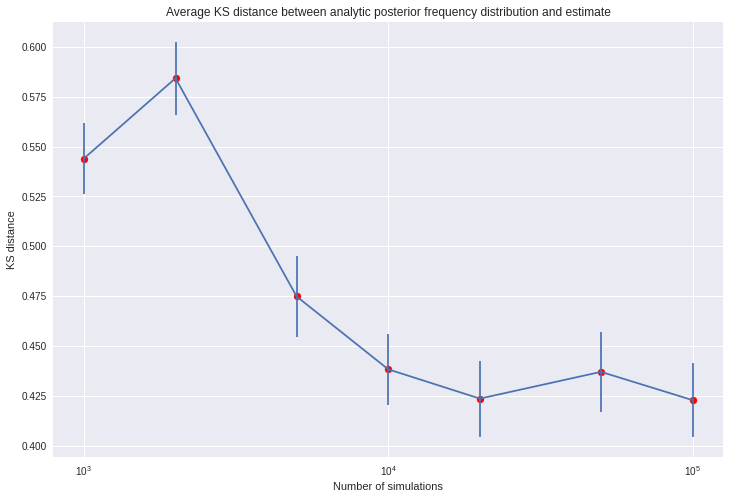

In [133]:
#Plot errors on frequency
x = [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]
plt.rc('font', size=20)
plt.figure(figsize=(12, 8))
plt.errorbar(x, np.mean(all_f_ks, axis=1), yerr=np.std(all_f_ks, axis=1)/10., markersize = 8, capsize = 10);
plt.scatter(x, np.mean(all_f_ks, axis=1), color = 'r');
plt.title('Average KS distance between analytic posterior frequency distribution and estimate')
plt.xscale('log')
plt.xlabel('Number of simulations')
plt.ylabel('KS distance')
#plt.gca().set_yticklabels([f'{x:.2%}' for x in plt.gca().get_yticks()]) ;

Text(0, 0.5, 'KS distance')

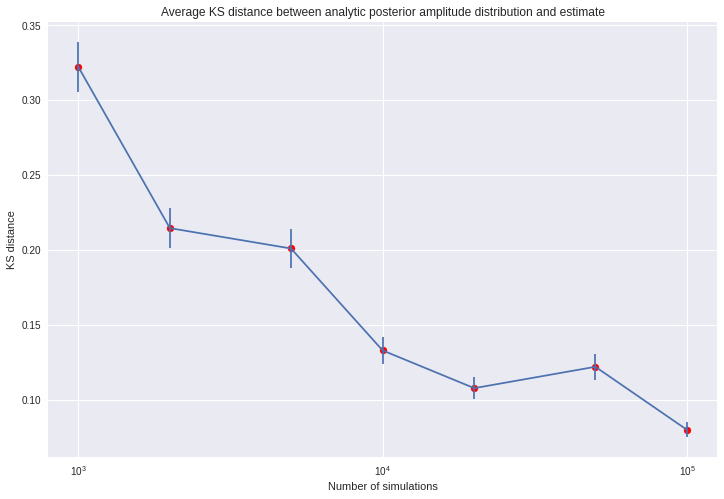

In [134]:
#Plot errors on amplitude
x = [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]
plt.rc('font', size=20)
plt.figure(figsize=(12, 8))
plt.errorbar(x, np.mean(all_a_ks, axis=1), yerr=np.std(all_a_ks, axis=1)/10., markersize = 8, capsize = 10);
plt.scatter(x, np.mean(all_a_ks, axis=1), color = 'r');
plt.title('Average KS distance between analytic posterior amplitude distribution and estimate')
plt.xscale('log')
plt.xlabel('Number of simulations')
plt.ylabel('KS distance')
#plt.gca().set_yticklabels([f'{x:.2%}' for x in plt.gca().get_yticks()]) ;

Text(0, 0.5, 'KS distance')

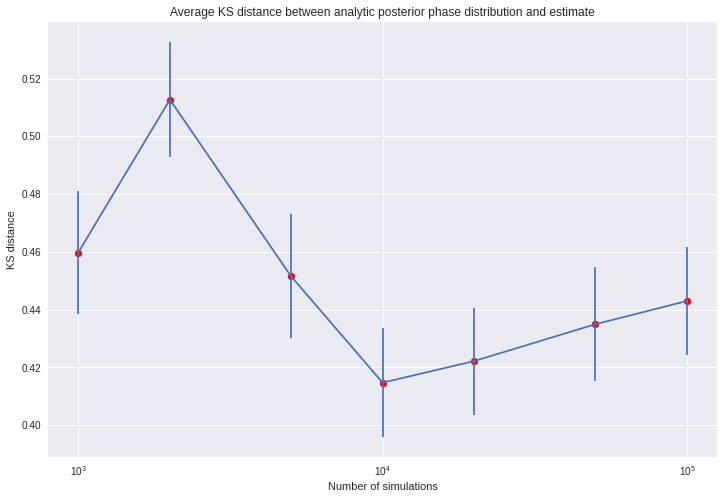

In [135]:
#Plot errors on phase
x = [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]
plt.rc('font', size=20)
plt.figure(figsize=(12, 8))
plt.errorbar(x, np.mean(all_p_ks, axis=1), yerr=np.std(all_p_ks, axis=1)/10., markersize = 8, capsize = 10);
plt.scatter(x, np.mean(all_p_ks, axis=1), color = 'r');
plt.title('Average KS distance between analytic posterior phase distribution and estimate')
plt.xscale('log')
plt.xlabel('Number of simulations')
plt.ylabel('KS distance')
#plt.gca().set_yticklabels([f'{x:.2%}' for x in plt.gca().get_yticks()]) ;

# Analysing CNN model with three parameters

In [19]:
#Define embedding net
class CNN(nn.Module): 
    
    def __init__(self): 
        super().__init__()
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=20, kernel_size=3, padding=1)
        self.pool1 = nn.MaxPool1d(kernel_size=3, stride=3)
        self.conv2 = nn.Conv1d(in_channels=20, out_channels=10, kernel_size=3, padding=1)
        self.pool2 = nn.MaxPool1d(kernel_size=3, stride=3)
        self.fc1 = nn.Linear(in_features=30, out_features=16) 
        self.fc2 = nn.Linear(in_features=16, out_features=8) 
        
    def forward(self, x):
        x = x.reshape(-1, 1, x.shape[1])
        x = self.pool2(F.relu(self.conv2(self.pool1(F.relu(self.conv1(x))))))
        x = x.reshape(-1, 30)
        x = F.relu(self.fc2(F.relu(self.fc1(x))))
        return x

In [20]:
#Inference part
all_f_ks = list()
all_a_ks = list()
all_p_ks = list()

for num_sims in [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]:
    print('XXXXXXXXXXXXXXXXXXXXXXXXXXX')
    print(f'NUM_SIMS: {num_sims}')
    start = time.time()
    with open(f'/home/electron/Documents/GW_Masters/Thesis/Notebooks/posteriors/{int(num_sims)}_{samp_freq}_cnn_multiple_posterior.pkl', 'rb') as input:
        posterior = pickle.load(input)
    ks_values = get_sample_data(posterior)
    all_f_ks.append(ks_values['freq'])
    all_a_ks.append(ks_values['amp'])
    all_p_ks.append(ks_values['phase'])

    end = time.time()

    print(f'Runtime: {end-start}')

XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 1000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 3.6006851196289062
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 2000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 3.7409894466400146
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 5000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 3.915452718734741
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 10000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 4.621979475021362
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 20000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 4.699762582778931
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 50000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 4.7675559520721436
XXXXXXXXXXXXXXXXXXXXXXXXXXX
NUM_SIMS: 100000.0


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

1


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

2


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

3


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

4


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

5


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

6


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

7


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

8


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

9


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

10
COUNT: 10


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

11


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

12


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

13


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

14


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

15


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

16


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

17


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

18


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

19


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

20
COUNT: 20


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

21


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

22


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

23


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

24


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

25


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

26


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

27


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

28


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

29


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

30
COUNT: 30


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

31


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

32


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

33


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

34


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

35


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

36


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

37


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

38


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

39


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

40
COUNT: 40


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

41


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

42


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

43


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

44


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

45


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

46


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

47


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

48


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

49


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

50
COUNT: 50


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

51


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

52


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

53


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

54


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

55


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

56


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

57


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

58


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

59


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

60
COUNT: 60


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

61


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

62


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

63


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

64


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

65


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

66


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

67


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

68


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

69


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

70
COUNT: 70


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

71


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

72


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

73


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

74


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

75


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

76


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

77


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

78


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

79


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

80
COUNT: 80


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

81


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

82


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

83


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

84


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

85


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

86


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

87


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

88


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

89


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

90
COUNT: 90


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

91


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

92


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

93


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

94


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

95


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

96


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

97


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

98


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

99


Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

100
COUNT: 100
Runtime: 4.8659303188323975


Text(0, 0.5, 'KS distance')

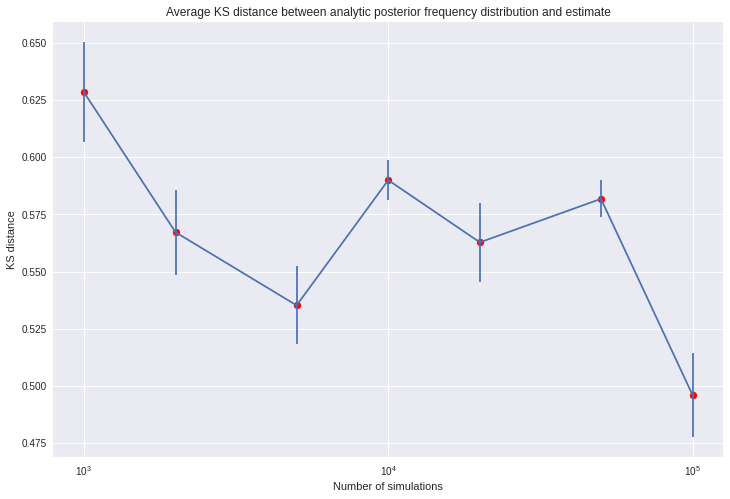

In [21]:
#Plot errors on frequency
x = [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]
plt.rc('font', size=20)
plt.figure(figsize=(12, 8))
plt.errorbar(x, np.mean(all_f_ks, axis=1), yerr=np.std(all_f_ks, axis=1)/10., markersize = 8, capsize = 10);
plt.scatter(x, np.mean(all_f_ks, axis=1), color = 'r');
plt.title('Average KS distance between analytic posterior frequency distribution and estimate')
plt.xscale('log')
plt.xlabel('Number of simulations')
plt.ylabel('KS distance')
#plt.gca().set_yticklabels([f'{x:.2%}' for x in plt.gca().get_yticks()]) ;

Text(0, 0.5, 'KS distance')

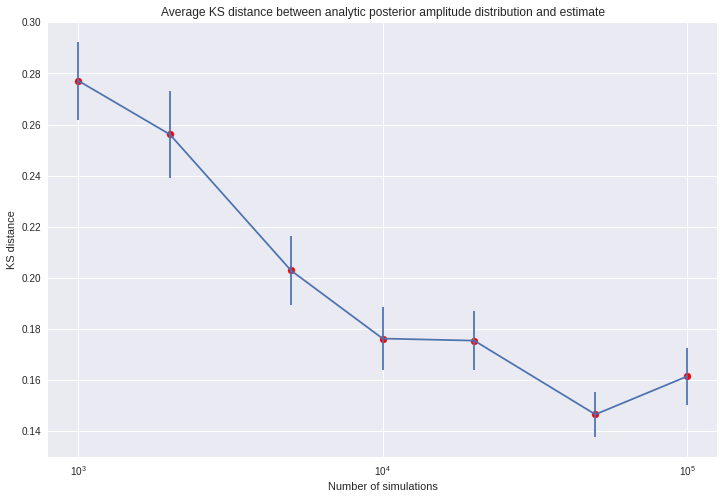

In [22]:
#Plot errors on amplitude
x = [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]
plt.rc('font', size=20)
plt.figure(figsize=(12, 8))
plt.errorbar(x, np.mean(all_a_ks, axis=1), yerr=np.std(all_a_ks, axis=1)/10., markersize = 8, capsize = 10);
plt.scatter(x, np.mean(all_a_ks, axis=1), color = 'r');
plt.title('Average KS distance between analytic posterior amplitude distribution and estimate')
plt.xscale('log')
plt.xlabel('Number of simulations')
plt.ylabel('KS distance')
#plt.gca().set_yticklabels([f'{x:.2%}' for x in plt.gca().get_yticks()]) ;

Text(0, 0.5, 'KS distance')

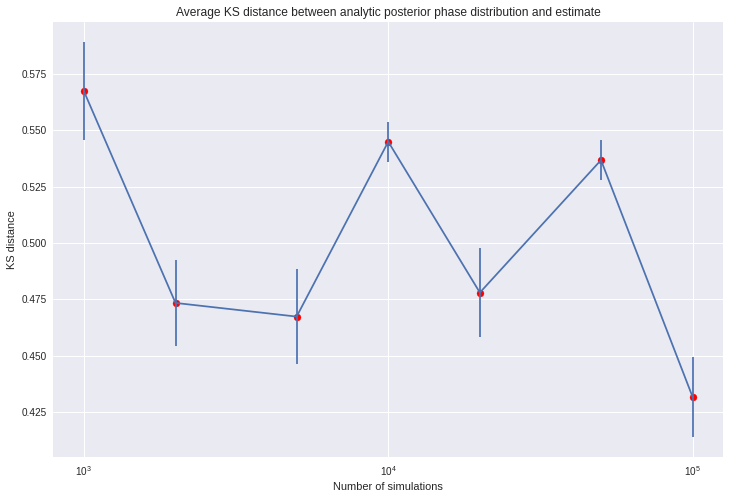

In [23]:
#Plot errors on phase
x = [1e3, 2e3, 5e3, 1e4, 2e4, 5e4, 1e5]
plt.rc('font', size=20)
plt.figure(figsize=(12, 8))
plt.errorbar(x, np.mean(all_p_ks, axis=1), yerr=np.std(all_p_ks, axis=1)/10., markersize = 8, capsize = 10);
plt.scatter(x, np.mean(all_p_ks, axis=1), color = 'r');
plt.title('Average KS distance between analytic posterior phase distribution and estimate')
plt.xscale('log')
plt.xlabel('Number of simulations')
plt.ylabel('KS distance')
#plt.gca().set_yticklabels([f'{x:.2%}' for x in plt.gca().get_yticks()]) ;